We use the uniform distribution for analytical find the conditionary expectation of profit

In [1]:
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt

In [2]:
def expectedProfit_montecarlo(distr, params, C, f, S, sigma2, n = 20000):
    answ = 0
    for i in range(n):
        cc = np.abs(distr(*params))
        answ -= f
        if cc<= sigma2:
            answ += S * 1/8*(sigma2-cc)**2
    return answ/n

In [3]:
C = np.random.uniform(1,2, size = 100)
expectedProfit_montecarlo(np.random.uniform, (1,2), C, 0.01, 1, 1.5)

np.float64(-0.004747350887573267)

In [4]:
a = 1
b = 2

C = np.random.uniform(a,b, size = 10000)
C2 = [x*x for x in C]
print(np.mean(C2))
print(1/3 * (b-a)**2 + a*(b-a) + a**2)

sigma2 = 1.5
print((1/3*(b-sigma2)**2 + sigma2*(b-sigma2) + sigma2**2)*0.5)

answ = 0
for x in C:
    if x >= sigma2:
        answ += x**2
print(answ/10000)

2.338229007682519
2.333333333333333
1.5416666666666667
1.5481256083038852


In [5]:
f = 0.01
a = 0.5
b = 1
sigma2 = 0.75

C = np.random.uniform(a,b, size = 100)
print(expectedProfit_montecarlo(np.random.uniform, (a,b), C, f, 1, sigma2))

P = 1/8*(sigma2**2 - sigma2 * (sigma2+a) +  (1/3*(sigma2-a)**2 + a*(sigma2-a) + a**2))*(sigma2-a)/(b-a)-f
PP = 1/24*((sigma2-a)**3/(b-a))-f
print(P)
print(PP)

-0.00873740931301648
-0.008697916666666665
-0.008697916666666666


In [7]:
S = 1

#parameters of firms
f = 0.001 # fixed costs
ef = 0.1 # entrance costs
r = 0.02 #return of interest
alpha = 0.965

a=1
b=1.5

sigma2 = (a+b)/2

cond = 24*f*(1+r-alpha)*(b-a)-S*(1-alpha)*(sigma2-a)**3
print(cond)

0.00011312500000000016


In [8]:
S = 10

#parameters of firms
f = 0.01 # fixed costs
ef = 0.1 # entrance costs
r = 0.02 #return of interest
alpha = 0.5

a=0.25
b=0.5

sigma2 = (a+b)/2
cond = 24*f*(1+r-alpha)*(b-a)-S*(1-alpha)*(sigma2-a)**3
print(cond)

0.021434375


In [231]:
class ApsundNokeModel():
    def __init__(self, distr, data, n_depth = 20000):
        self.distr = distr
        self.setData(data)
        self.n_depth = n_depth
    
    def setData(self, data):
        self.data = data
        self.n_epochs = data.shape[0]
        self.k_params = 0
        for x in self.data.columns:
            if x[0:5] == "param":
                self.k_params+=1

    def getParams(self, epoch):
        params = (self.data[f"param_0"][epoch],)
        for i in range(1, self.k_params):
            params += (self.data[f"param_{i}"][epoch],)
        return params
        
    
    def Sigma2(self, C, epoch):
        sigma = self.data["sigma"][epoch]
        return (2+sigma*np.sum(C))/(2+sigma*len(C))
    
    def expectedProfit_montecarlo(self, C, epoch):
        f = self.data["f"][epoch]
        S = self.data["S"][epoch]
        params = self.getParams(epoch)
        n = self.n_depth
        sigma2 = self.Sigma2(C, epoch)
        if self.distr == np.random.uniform:
            a, b = params[0], params[1]
            if sigma2 < a:
                return -f
            if sigma2 > b:
                sigma2 = b
            return S * 1/8*(sigma2**2 - sigma2 * (sigma2+a) +  (1/3*(sigma2-a)**2 + a*sigma2))*(sigma2-a)/(b-a)-f

        answ = 0
        for i in range(n):
            cc = np.abs(self.distr(*params))
            answ -= f
            if cc>= sigma2:
                answ += S * 1/8*(sigma2-cc)**2
        return answ/n

    def NPV_for_entrant(self, C, epoch):
        r = self.data["r"][epoch]
        return ((1+r)/r) * self.expectedProfit_montecarlo(C, epoch)
    
    def scenario(self, out = False):
        #data prepare
        NPV_ent = [0] * self.n_epochs
        M = [0] * self.n_epochs
        P_mean = [0] * self.n_epochs
        EP_ = [0] * self.n_epochs
        C_mean = [0] * self.n_epochs
        C_max = [0] * self.n_epochs
        C_min_ex = [0] * self.n_epochs
        Sigma2 = [0] * self.n_epochs
        M_ent = [0] * self.n_epochs
        M_ex = [0] * self.n_epochs
        _EP_ent = [0] * self.n_epochs

        #zero epoch
        params = self.getParams(0)
        C = np.abs(self.distr(*params, size = 10))
        
        for epoch in range(self.n_epochs):
            #loading data
            params = self.getParams(epoch)
            f = self.data["f"][epoch]
            r = self.data["r"][epoch]
            ef = self.data["ef"][epoch]
            alpha = self.data["alpha"][epoch]
            S = self.data["S"][epoch]

            NPV1 = self.NPV_for_entrant(C, epoch)
            EP = self.expectedProfit_montecarlo(C, epoch)
            #entrance stage
            n_ent = 0
            while NPV1 > ef:
                c = np.abs(self.distr(*params, size = 1))
                C = np.append(C, c)
                n_ent += 1
                NPV1 = self.NPV_for_entrant(C, epoch)

            EP = self.expectedProfit_montecarlo(C, epoch)
            _EP_ent[epoch] = EP

            #recounting stage
            for i in range(len(C)):
                a = random.random()
                if a > alpha:
                    C[i] = np.abs(self.distr(*params))
            
            # sort of C
            #C = np.flip(np.sort(C))

            # exit stage
            EP = self.expectedProfit_montecarlo(C, epoch)
            sigma2 = self.Sigma2(C, epoch)
            n_ex = 0
            i = 0
            P_fact = []
            C_min_exited = np.amax(C)
            while (i < len(C)):
                P = - f
                if sigma2 > C[i]:
                    P = S * 1/8*(sigma2 - C[i])**2 - f
                P_fact.append(P)
                NPV2 = (1+r)/(1+r-alpha) * P + (1/r - alpha/(1+r-alpha))*EP
                if NPV2 < 0:
                    C_min_exited = min(C_min_exited, C[i])
                    C = np.delete(C, i)
                    n_ex += 1
                    EP = self.expectedProfit_montecarlo(C, epoch)
                    sigma2 = self.Sigma2(C, epoch)
                else:
                    i += 1
            NPV_ent[epoch] = NPV1
            M[epoch] = len(C)
            P_mean[epoch] = np.mean(P_fact)
            EP_[epoch] = EP
            C_mean[epoch] = np.mean(C)
            C_max[epoch] = np.amax(C)
            C_min_ex[epoch] = C_min_exited
            Sigma2[epoch] = sigma2
            M_ent[epoch] = n_ent
            M_ex[epoch] = n_ex

            if out:
                print(f"epoch{epoch}, number of firms: {M[epoch]}, entrats: {M_ent[epoch]}, exiters: {M_ex[epoch]}, EP: {EP_[epoch]}, C_mean: {C_mean[epoch]}, EP_fact: {P_mean[epoch]}")
        
        self.data["NPV_ent"] = NPV_ent
        self.data["n_firms"] = M
        self.data["Pr_mean"] = P_mean
        self.data["EP"] = EP_
        self.data["C_mean"] = C_mean
        self.data["C_max"] = C_max
        self.data["C_min_ex"] = C_min_ex
        self.data["Sigma2"] = Sigma2
        self.data["n_entr"] = M_ent
        self.data["n_ext"] = M_ex
        self.data["_EP_ent"] = _EP_ent

    def getData(self):
        return self.data

In [298]:
#parameters of distribution
Ec = 2
Dc = 0.04
scale = Dc**0.5

#parameters of utility
sigma = 1
S = 10

#parameters of firms
f = 0.01 # fixed costs
ef = 0.025 # entrance costs
r = 0.1 #return of interest
alpha = 0.895

n = 100000

data = {"param_0": [0.25]*n,
        "param_1": [0.5]*n,
        "sigma": [sigma]*n,
        "S": [S]*n,
        "f": [f]*n,
        "ef": [ef]*n,
        "r": [r]*n,
        "alpha": [alpha]*n}

df = pd.DataFrame(data)


,param_0,param_1,sigma,S,f,ef,r,alpha
0,0.25,0.5,1,10,0.01,0.025,0.1,0.895
1,0.25,0.5,1,10,0.01,0.025,0.1,0.895
2,0.25,0.5,1,10,0.01,0.025,0.1,0.895
3,0.25,0.5,1,10,0.01,0.025,0.1,0.895
4,0.25,0.5,1,10,0.01,0.025,0.1,0.895
...,...,...,...,...,...,...,...,...
99995,0.25,0.5,1,10,0.01,0.025,0.1,0.895
99996,0.25,0.5,1,10,0.01,0.025,0.1,0.895
99997,0.25,0.5,1,10,0.01,0.025,0.1,0.895
99998,0.25,0.5,1,10,0.01,0.025,0.1,0.895


In [315]:
results = []
alpha = 0.8
while alpha < 0.95:
    print("#", end = '')
    data['alpha'] = alpha
    Noke = ApsundNokeModel(distr = np.random.uniform, data=pd.DataFrame(data))
    Noke.scenario(out=False)
    
    results.append( Noke.getData() )
    alpha += 0.02


########

In [338]:
answs = []
for result in results:
    _alpha = result['alpha'].mean()
    M = result['n_firms'].mean()
    K = result['n_entr'].mean()
    C_max = result['C_max'].mean()
    C_mean = result['C_mean'].mean()
    sigma3_f = result['Sigma2'].mean()
    sigma3 = (1+sigma*M*(C_max-a)/(b-a))/(1+sigma*M)
    Pc_f = (C_max-a)/(b-a)
    Pc_r = (K/M / (1-_alpha)+1)**(-1)
    C_max_r = Pc_r * (b-a) +a

    answs.append([_alpha, M, K, C_max, C_mean, (C_max+a)/2, sigma3, sigma3_f, Pc_f, Pc_r, C_max_r])
    
pd.DataFrame(answs, columns=['alpha','M', 'K', 'Cmax', 'Cmean', 'Cmean_r', 'sigma3', 'sigma3_f', 'Pc_f', "Pc_r", "C_max_r"])

,alpha,M,K,Cmax,Cmean,Cmean_r,sigma3,sigma3_f,Pc_f,Pc_r,C_max_r
0,0.80,8.25535,1.77887,0.378744,0.314635,0.314372,0.567380,0.450039,0.514975,0.481370,0.370342
1,0.82,8.09303,1.67598,0.370746,0.311752,0.310373,0.539843,0.449546,0.482985,0.465009,0.366252
2,0.84,7.92351,1.57285,0.362627,0.308436,0.306313,0.512084,0.449013,0.450506,0.446299,0.361575
3,0.86,7.81659,1.43856,0.355276,0.305865,0.302638,0.486762,0.448337,0.421102,0.432046,0.358012
4,0.88,7.73178,1.29606,0.348645,0.303175,0.299322,0.463915,0.447380,0.394580,0.417206,0.354302
5,0.90,7.68733,1.13546,0.343534,0.301004,0.296767,0.446180,0.446289,0.374136,0.403705,0.350926
6,0.92,7.67903,0.94259,0.339189,0.299006,0.294594,0.430870,0.444834,0.356755,0.394577,0.348644
7,0.94,7.74206,0.73703,0.336304,0.298214,0.293152,0.420118,0.443228,0.345218,0.386602,0.346651


In [299]:
Noke = ApsundNokeModel(distr = np.random.uniform,
                       data = df)

In [300]:
Noke.scenario(out=True)

epoch0, number of firms: 8, entrats: 2, exiters: 4, EP: 0.002675704939409612, C_mean: 0.30832033351508426, EP_fact: 0.006787625766323863
epoch1, number of firms: 8, entrats: 1, exiters: 1, EP: 0.00347988897510167, C_mean: 0.3134126370811971, EP_fact: 0.011886681470474225
epoch2, number of firms: 8, entrats: 1, exiters: 1, EP: 0.0029450048033149434, C_mean: 0.3100489955248115, EP_fact: 0.01228317360261087
epoch3, number of firms: 9, entrats: 2, exiters: 1, EP: 0.0012904623918974928, C_mean: 0.3145954530480243, EP_fact: 0.008892287329688242
epoch4, number of firms: 9, entrats: 0, exiters: 0, EP: 0.002314740517527567, C_mean: 0.3213874416811804, EP_fact: 0.009818093879435276
epoch5, number of firms: 9, entrats: 1, exiters: 1, EP: 0.0030872769218376565, C_mean: 0.3262647539524772, EP_fact: 0.007434716001657434
epoch6, number of firms: 8, entrats: 2, exiters: 3, EP: 0.0018574701556132982, C_mean: 0.3029129051789256, EP_fact: 0.008704922233492902
epoch7, number of firms: 7, entrats: 0, exite

In [301]:
result = Noke.getData()
result.describe()

,param_0,param_1,sigma,S,f,ef,r,alpha,NPV_ent,n_firms,Pr_mean,EP,C_mean,C_max,C_min_ex,Sigma2,n_entr,n_ext,_EP_ent
count,100000.00,100000.0,100000.0,100000.0,1.000000e+05,1.000000e+05,1.000000e+05,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,8.950000e-01,0.012950,7.701160,0.014078,0.002767,0.301646,0.344708,0.382956,0.446590,1.175550,1.175580,0.001177
std,0.00,0.0,0.0,0.0,1.734732e-18,3.469464e-18,1.387786e-17,3.330686e-16,0.008254,0.738796,0.004748,0.002068,0.013560,0.023684,0.049416,0.010261,1.709948,1.517088,0.000750
min,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,8.950000e-01,-0.039300,5.000000,-0.003058,-0.003573,0.255713,0.259625,0.259625,0.406817,0.000000,0.000000,-0.003573
25%,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,8.950000e-01,0.007371,7.000000,0.010703,0.001318,0.292932,0.331632,0.343942,0.439369,0.000000,0.000000,0.000670
50%,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,8.950000e-01,0.014132,8.000000,0.015040,0.002322,0.301151,0.342626,0.369476,0.444808,1.000000,1.000000,0.001285
75%,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,8.950000e-01,0.019800,8.000000,0.016594,0.003936,0.309700,0.353639,0.417366,0.452971,2.000000,2.000000,0.001800
max,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,8.950000e-01,0.024999,13.000000,0.033288,0.016042,0.398863,0.499974,0.500000,0.514005,21.000000,21.000000,0.002273


In [295]:
ef*r/(1+r), result['_EP_ent'].max()

(0.002272727272727273, np.float64(0.0022727130746061086))

In [302]:
def e_sqrt(a, b):
    return (b-a)**2 / 3 + a * b

M = result['n_firms'].mean()
C_max = result['C_max'].mean()
C_min_ex = result['C_min_ex'].mean()
C_mean = result['C_mean'].mean()
M_sq = np.pow(result['n_firms'], 2).mean()
sigma3_f = result['Sigma2'].mean()
C_ = (C_max + C_min_ex) /2


sigma3 = (1+sigma*M*(C_max-a)/(b-a))/(1+sigma*M)

#sigma3 = sigma3_f

sigma3_2 = (1 + 2*sigma*M*(4*C_max-1) + sigma**2 * M_sq * np.sqrt(4*C_max-1))/(1+2*sigma*M + sigma**2 * M_sq)

sigma3_2 = np.pow(result['Sigma2'], 2).mean()

#EP0 = S / 8 * np.row(result['Sigma2'] - result[''])
EP = S / 8 * (sigma3**2 - sigma3 * (sigma3+a) + e_sqrt(a, sigma3)) *(sigma3-a)/(b-a)  - f
PC = S/8 * (sigma3_f-C_min_ex)**2 - f
EPP = - PC*(1+r)/(1+r-alpha) / (1/r - alpha/(1+r-alpha))

sigma3/sigma3_f, EP, EPP

(np.float64(1.0081318866778426),
 np.float64(0.00337777110443116),
 np.float64(0.004703204210082195))

In [ ]:
#parameters of distribution
Ec = 2
Dc = 0.04
scale = Dc**0.5

#parameters of utility
sigma = 1
S = 10

#parameters of firms
f = 0.0025 # fixed costs
ef = 0.025 # entrance costs
r = 0.1 #return of interest
alpha = 0.9

n = 100000

data = {"param_0": [0.25]*n,
        "param_1": [0.5]*n,
        "sigma": [sigma]*n,
        "S": [S]*n,
        "f": [f]*n,
        "ef": [ef]*n,
        "r": [r]*n,
        "alpha": [alpha]*n}

df = pd.DataFrame(data)
Noke = ApsundNokeModel(distr = np.random.uniform,
                       data = df)
Noke.scenario(out=True)

In [126]:
result = Noke.getData()
result.describe()

,param_0,param_1,sigma,S,f,ef,r,alpha,NPV_ent,n_firms,Pr_mean,EP,C_mean,C_max,C_min_ex,Sigma2,n_entr,n_ext
count,100000.00,100000.0,100000.0,100000.0,1.000000e+05,1.000000e+05,1.000000e+05,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.012792,7.680010,0.014287,0.002702,0.300826,0.343191,0.381514,0.446251,1.129690,1.129710
std,0.00,0.0,0.0,0.0,1.734732e-18,3.469464e-18,1.387786e-17,1.110229e-16,0.008346,0.736371,0.004698,0.002065,0.013151,0.022342,0.049716,0.010272,1.680452,1.478448
min,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,-0.035562,5.000000,-0.002464,-0.003233,0.256584,0.263293,0.263293,0.409533,0.000000,0.000000
25%,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.007147,7.000000,0.010882,0.001268,0.292127,0.331018,0.342475,0.439089,0.000000,0.000000
50%,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.014018,8.000000,0.015181,0.002238,0.300455,0.341526,0.366999,0.444369,0.000000,1.000000
75%,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.019655,8.000000,0.016706,0.003846,0.308850,0.352207,0.415862,0.452531,2.000000,1.000000
max,0.25,0.5,1.0,10.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.025000,14.000000,0.033028,0.016042,0.405417,0.499943,0.499998,0.512506,24.000000,23.000000


In [127]:
#parameters of distribution
Ec = 2
Dc = 0.04
scale = Dc**0.5

#parameters of utility
sigma = 1
S = 30

#parameters of firms
f = 0.01 # fixed costs
ef = 0.025 # entrance costs
r = 0.1 #return of interest
alpha = 0.9

n = 100000

data = {"param_0": [0.25]*n,
        "param_1": [0.5]*n,
        "sigma": [sigma]*n,
        "S": [S]*n,
        "f": [f]*n,
        "ef": [ef]*n,
        "r": [r]*n,
        "alpha": [alpha]*n}

df = pd.DataFrame(data)
Noke = ApsundNokeModel(distr = np.random.uniform,
                       data = df)
Noke.scenario(out=True)

epoch0, number of firms: 26, entrats: 107, exiters: 91, EP: -0.006754427277777968, C_mean: 0.2855526014552471, EP_fact: -0.003252973933699452
epoch1, number of firms: 14, entrats: 0, exiters: 12, EP: -0.00370794863624856, C_mean: 0.26624318453561363, EP_fact: 0.008769828077449405
epoch2, number of firms: 12, entrats: 0, exiters: 2, EP: -0.0008736188458594203, C_mean: 0.26757924885804296, EP_fact: 0.031134216276210346
epoch3, number of firms: 12, entrats: 0, exiters: 0, EP: -0.0008736188458594203, C_mean: 0.26757924885804296, EP_fact: 0.03166003440544427
epoch4, number of firms: 12, entrats: 0, exiters: 0, EP: -0.0008736188458594203, C_mean: 0.26757924885804296, EP_fact: 0.03166003440544427
epoch5, number of firms: 11, entrats: 0, exiters: 1, EP: 0.0032831925668543437, C_mean: 0.2773160642220603, EP_fact: 0.03433434306160573
epoch6, number of firms: 12, entrats: 1, exiters: 0, EP: 0.0024986444802230084, C_mean: 0.2833353038439463, EP_fact: 0.031561468662190485
epoch7, number of firms: 1

In [128]:
result = Noke.getData()
result.describe()

,param_0,param_1,sigma,S,f,ef,r,alpha,NPV_ent,n_firms,Pr_mean,EP,C_mean,C_max,C_min_ex,Sigma2,n_entr,n_ext
count,100000.00,100000.0,100000.0,100000.0,1.000000e+05,1.000000e+05,1.000000e+05,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000
mean,0.25,0.5,1.0,30.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.002788,13.059940,0.024900,0.001243,0.281640,0.319348,0.361901,0.379541,5.068510,5.06849
std,0.00,0.0,0.0,0.0,1.734732e-18,3.469464e-18,1.387786e-17,1.110229e-16,0.023706,3.207006,0.009944,0.003382,0.010743,0.029613,0.059070,0.014100,18.703694,15.66350
min,0.25,0.5,1.0,30.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,-0.105150,9.000000,-0.004268,-0.009559,0.255520,0.262301,0.250009,0.294511,0.000000,0.00000
25%,0.25,0.5,1.0,30.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,-0.007309,12.000000,0.019578,-0.000664,0.274590,0.303948,0.316435,0.373137,0.000000,0.00000
50%,0.25,0.5,1.0,30.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.011918,13.000000,0.025865,0.001369,0.280968,0.317254,0.345670,0.381496,0.000000,1.00000
75%,0.25,0.5,1.0,30.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.020070,14.000000,0.031414,0.003068,0.287451,0.328495,0.402016,0.387746,2.000000,3.00000
max,0.25,0.5,1.0,30.0,1.000000e-02,2.500000e-02,1.000000e-01,9.000000e-01,0.025000,104.000000,0.070254,0.029175,0.377847,0.499988,0.499993,0.448616,542.000000,451.00000


In [22]:
4.986020/22.520190, 2.763440/10.369000

(0.22140221729923237, 0.26650978879351916)

In [18]:
#np.mean(result["C_mean"])
k = 0
for i in result["C_mean"]:
    if i > 2.75:
        k+=1
k

0

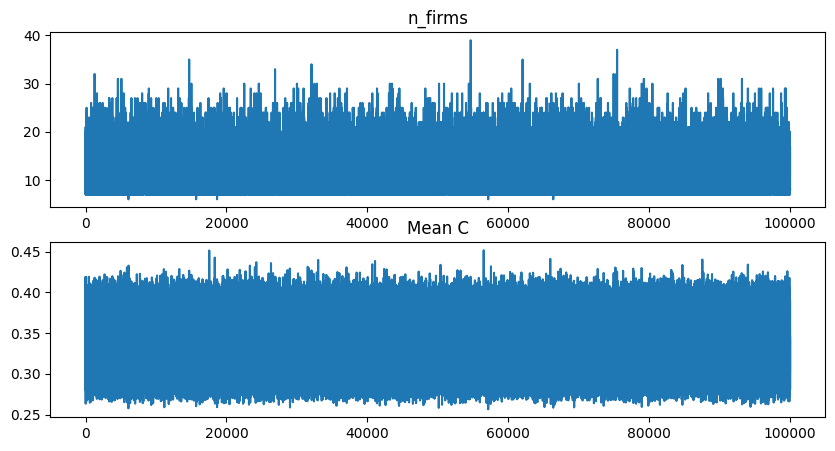

In [17]:
plt.figure(figsize=(10,5))
plt.subplot(2,1,1)
plt.title('n_firms')
plt.plot(result["n_firms"])
plt.subplot(2,1,2)
plt.title('Mean C')
plt.plot(result["C_mean"])